**images:**  `.//CenterNet//data//coco//images`
 
**results:** `//CenterNet//exp//multi_pose//default//result_poseval.json`

In [38]:
import json
data = json.load(open('.//CenterNet//exp//multi_pose//default//result_poseval.json'))

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cbook as cbook

In [108]:
def setPredJoints(imageDir, image_name, rgbPoint = (255, 0, 0), radius = 5):
    imagePath = imageDir + '/' + image_name
    with cbook.get_sample_data(imagePath) as image_file:
        image1 = plt.imread(image_file)
    image = image1.copy()
    tmp = {}
    maxx = len(image)
    maxy = len(image[0])
    for img in data['annolist']:
        if img['image'][0]['name'] == image_name:
            tmp = img
    best = tmp['annorect'][0]
    for var in tmp['annorect']:
        if var['score'][0] > best['score'][0]:
            best = var
    points = best['annopoints'][0]['point']
    for point in points:
        x = point['x'][0]
        y = point['y'][0]
        for i in range(max(0,int(x) - radius), min(maxx, int(x) + radius)):
            for j in range(max(0,int(y) - radius), min(maxy, int(y) + radius)):
                image[j][i] = rgbPoint
    return image

In [76]:
def showImage(image):
    fig, ax = plt.subplots()

    ax.imshow(image)
    ax.set_title(type(image))

    fig.set_figwidth(10)    #  ширина и
    fig.set_figheight(10)    #  высота "Figure"

    plt.show()

In [100]:
def getListOfImages(data):
    lst = []
    for img in data['annolist']:
        lst.append(img['image'][0]['name'])
    
    return lst

In [101]:
def main(imgIndex):
    images = getListOfImages(data)
    image = setPredJoints('/CenterNet/data/coco/images', images[imgIndex])
    showImage(image)

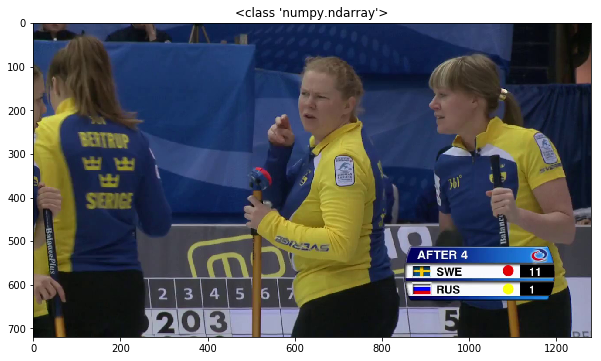

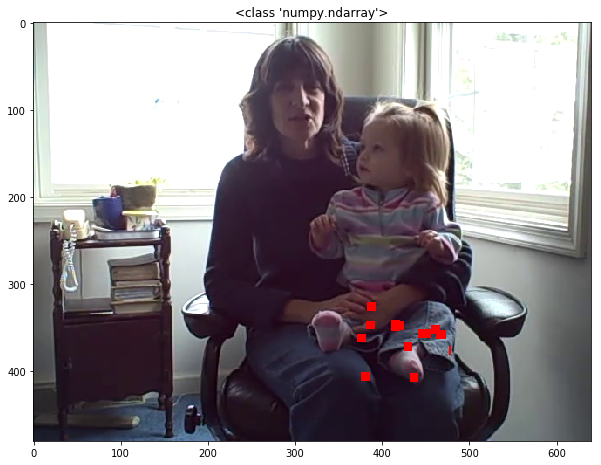

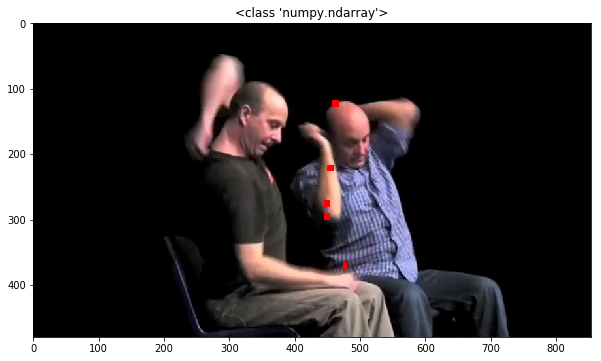

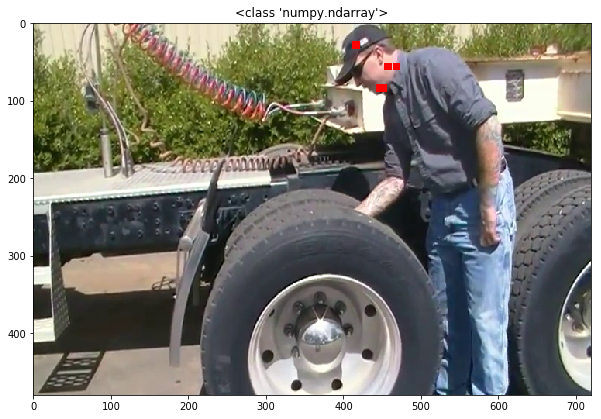

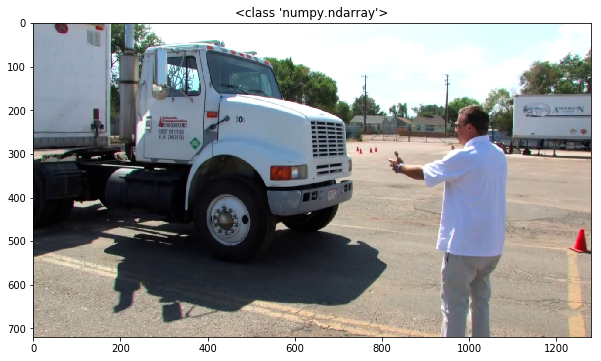

...

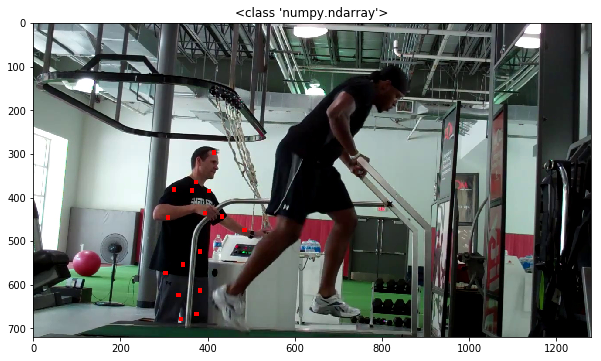

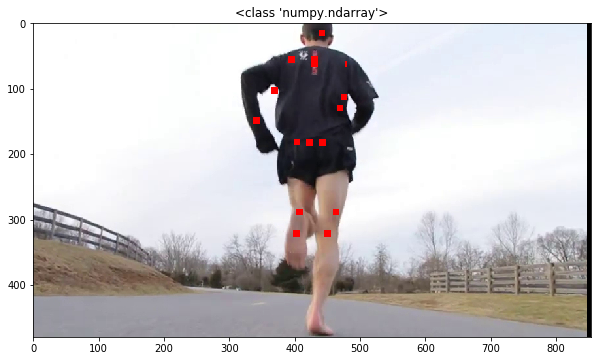

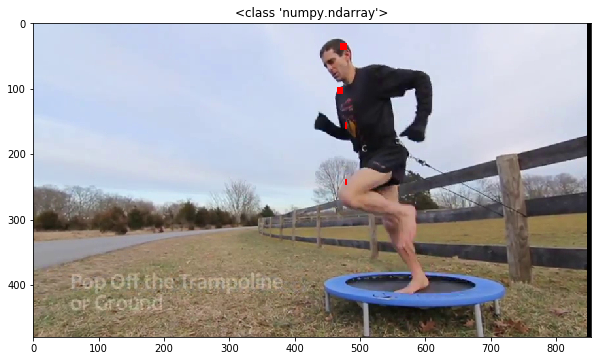

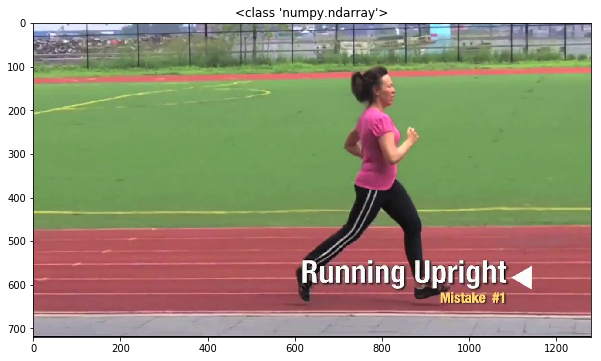

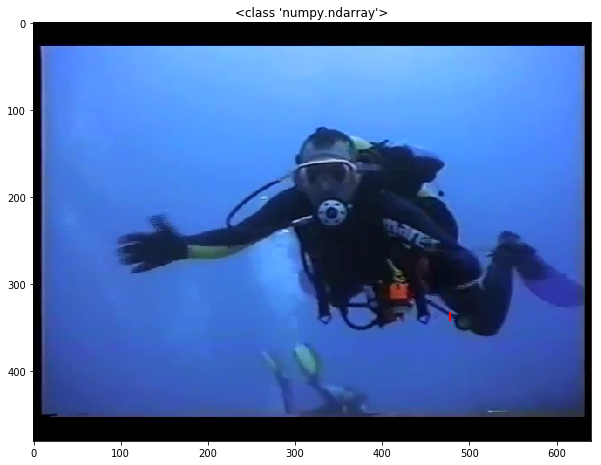

In [109]:
for i in range(0,100):
    main(i)